<a href="https://colab.research.google.com/github/TranAnh35/CodeForAI/blob/main/BaiTapLonAI.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Khai Báo Thư Viện

In [1]:
!pip install mplfinance

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 73.1/73.1 kB 1.5 MB/s eta 0:00:00


In [2]:
# Khai báo thư viện
import math
import pandas as pd # Đọc dữ liệu
import numpy as np # Xử lý dữ liệu
import matplotlib.pyplot as plt # Vẽ biểu đồ
import mplfinance as mpf # Vẽ biểu đồ dạng nến
from sklearn.preprocessing import MinMaxScaler # Chuẩn hóa dữ liệu
from keras.models import Sequential
from keras.layers import Dense, LSTM, Dropout
from statsmodels.tsa.arima.model import ARIMA
from keras.callbacks import ModelCheckpoint # Lưu mô hình tốt nhất trong quá trình huấn luyện
from keras.models import load_model
import datetime as dt # Tạo đối tượng DateTime
import yfinance as yf # Thu thập thông tin từ Yahoo Financa
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf # Vẽ biểu đồ autocorrelation và partial autocorrelation

#Kiểm tra độ chính xác của mô hình
from sklearn.metrics import mean_absolute_percentage_error, mean_squared_error, mean_absolute_error, r2_score

# Đọc Dữ Liệu

Để đọc được dữ liệu từ file thì mình có tìm thấy cách truyền file lên trên google drive xong import như dưới

In [3]:
from google.colab import drive 
drive.mount('/content/gdrive')  # Kết nối Google Drive với Colab

Mounted at /content/gdrive


In [4]:
file = 'gdrive/My Drive/GOOGL.csv'
df = pd.read_csv(file)

# Mô Tả Dữ Liệu

In [5]:
# Định dạng cấu trúc thời gian
df['Date'] = pd.to_datetime(df['Date'],format="%Y-%m")
df = df.set_index('Date')

In [ ]:
# Kích thức dữ liệu
df.shape

(1259, 6)

In [ ]:
# Dữ liệu 5 dòng đầu
df.head(5)

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2018-04-30,51.721001,51.918499,50.915001,50.929001,50.929001,34492000
2018-05-01,50.814999,52.086498,50.530499,52.037498,52.037498,35326000
2018-05-02,51.700001,52.199001,51.158001,51.302502,51.302502,34698000
2018-05-03,51.268501,51.534500,50.394501,51.314999,51.314999,39282000
2018-05-04,50.980499,52.594002,50.902500,52.549999,52.549999,36892000


In [ ]:
# Xác định kiểu dữ liệu
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1259 entries, 2018-04-30 to 2023-04-28
Data columns (total 6 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   Open       1259 non-null   float64
 1   High       1259 non-null   float64
 2   Low        1259 non-null   float64
 3   Close      1259 non-null   float64
 4   Adj Close  1259 non-null   float64
 5   Volume     1259 non-null   int64  
dtypes: float64(5), int64(1)
memory usage: 68.9 KB


In [ ]:
# Mô tả dữ liệu
df.describe()

,Open,High,Low,Close,Adj Close,Volume
count,1259.000000,1259.000000,1259.000000,1259.000000,1259.000000,1.259000e+03
mean,88.476288,89.487536,87.492475,88.517284,88.517284,3.481561e+07
std,29.818333,30.110628,29.462846,29.781341,29.781341,1.550042e+07
min,49.216000,50.605999,48.882999,49.233501,49.233501,9.312000e+06
25%,60.390249,60.982500,59.981251,60.500000,60.500000,2.502970e+07
50%,81.608002,82.912003,80.711998,81.649002,81.649002,3.104720e+07
75%,112.594750,114.007000,111.425499,112.673748,112.673748,3.992900e+07
max,151.250000,151.546494,148.899002,149.838501,149.838501,1.331780e+08


# Tiền Xử Lí Dữ Liệu

In [ ]:
dfc = pd.DataFrame(df, columns=['Close'])
dfv = pd.DataFrame(df, columns=["Volume"])
dfv['Volume'] = dfv['Volume'] / (10**6) # Giảm đơn vị của giá trị trong cột Volume

## Vẽ biểu đồ

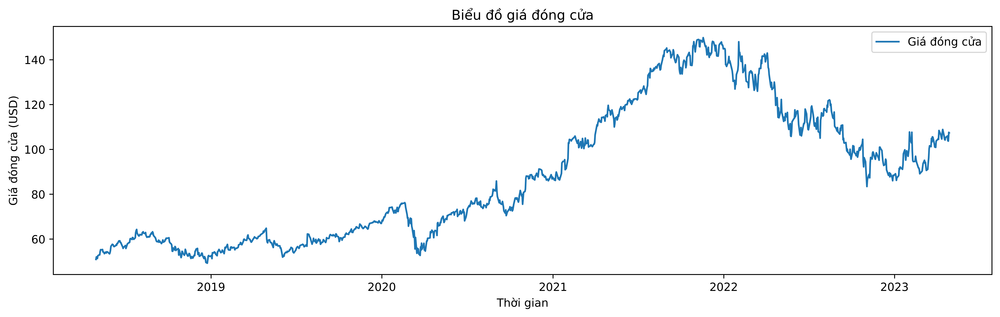

In [ ]:
# Lập biểu đồ đóng cửa
plt.figure(figsize=(15,4), dpi=1000)
plt.plot(dfc, label='Giá đóng cửa') # Lập biểu đồ
plt.title("Biểu đồ giá đóng cửa") # Đặt tên biểu đò
plt.xlabel("Thời gian") # Đặt tên hàm x
plt.ylabel("Giá đóng cửa (USD)") # Đặt tên hàm y
plt.legend() # chú thích
plt.show()

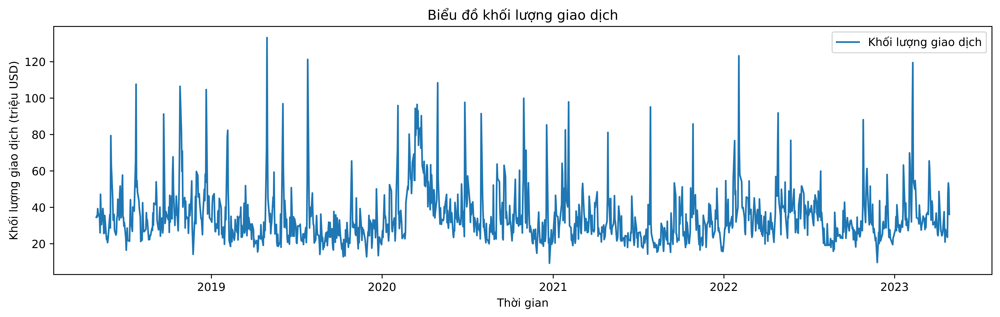

In [ ]:
#Lập biểu đồ khối lượng giao dịch
plt.figure(figsize=(15,4), dpi=1000)
plt.plot(dfv, label='Khối lượng giao dịch') # Lập biểu đồ
plt.title("Biểu đồ khối lượng giao dịch") # Đặt tên biểu đò
plt.xlabel("Thời gian") # Đặt tên hàm x
plt.ylabel("Khối lượng giao dịch (triệu USD)") # Đặt tên hàm y
plt.legend() # chú thích
plt.show()

In [ ]:
# Tính toán lợi nhuận hàng ngày bằng cách sử dụng pct_change
df['Dayly Return'] = df['Adj Close'].pct_change()

# Vẽ biểu đồ lợi nhuận hàng ngày
plt.figure(figsize=(20,10), dpi=1000)
plt.plot(df['Dayly Return'], label='Lợi nhuận hàng ngày', linestyle='--', marker='o')
plt.title("Biểu đồ lợi nhuận hàng ngày của cổ phiếu GOOGLE")
plt.xlabel("Thời gian")
plt.ylabel("Tỉ lệ thay đổi (%)")
plt.legend()
plt.show()

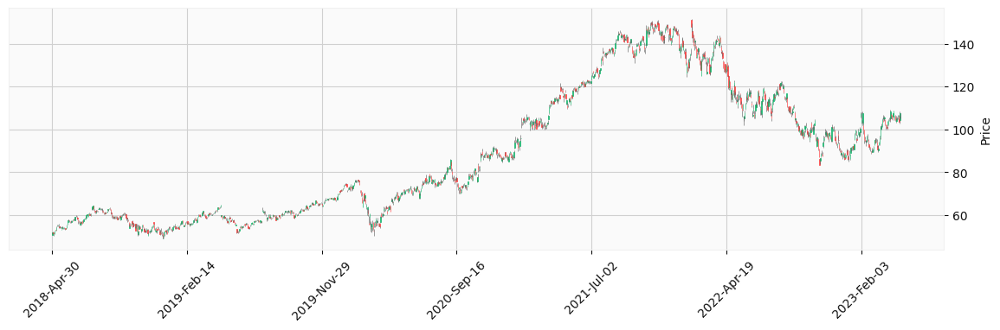

In [ ]:
# Vẽ Biểu Đồ Nến
mpf.plot(df, type="candle", style='yahoo', figsize=(15,4), figscale=5, warn_too_much_data=1500)

## Các Chỉ Số Kĩ Thuật

### Đường trung bình động

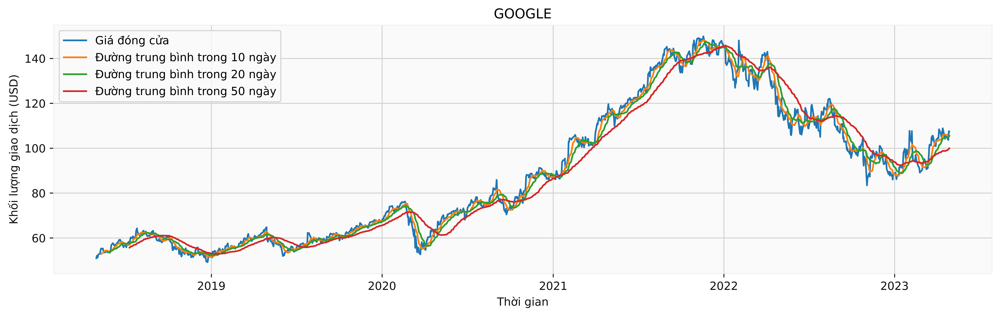

In [ ]:
# Đường trung bình động cho giá đóng của
ma_day = [10, 20, 50]

for ma in ma_day:
    column_name = f"MA for {ma} days"
    dfc[column_name] = dfc['Close'].rolling(ma).mean()

plt.figure(figsize=(15,4), dpi=1000)
plt.plot(dfc['Close'], label='Giá đóng cửa')
plt.plot(dfc['MA for 10 days'], label='Đường trung bình trong 10 ngày')
plt.plot(dfc['MA for 20 days'], label='Đường trung bình trong 20 ngày')
plt.plot(dfc['MA for 50 days'], label='Đường trung bình trong 50 ngày')
plt.title("GOOGLE")
plt.xlabel("Thời gian")
plt.ylabel("Khối lượng giao dịch (USD)")
plt.legend()
plt.show()

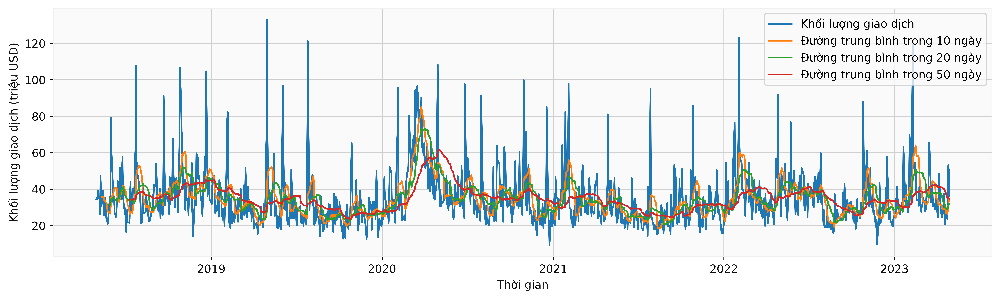

In [ ]:
# Đường trung bình động của khối lượng giao dịch
ma_day = [10, 20, 50]

for ma in ma_day:
    column_name = f"MA for {ma} days"
    dfv[column_name] = dfv['Volume'].rolling(ma).mean()

plt.figure(figsize=(15,4), dpi=1000)
plt.plot(dfv['Volume'], label='Khối lượng giao dịch')
plt.plot(dfv['MA for 10 days'], label='Đường trung bình trong 10 ngày')
plt.plot(dfv['MA for 20 days'], label='Đường trung bình trong 20 ngày')
plt.plot(dfv['MA for 50 days'], label='Đường trung bình trong 50 ngày')
plt.xlabel("Thời gian")
plt.ylabel("Khối lượng giao dịch (triệu USD)")
plt.legend()

### Dải Bollinger

In [ ]:
# Chọn đường SMA 20 là đường trung tâm
# Tính toán độ lệch chuẩn 20 ngày theo chiều dọc tiêu chuẩn
dfc['20_std_Close'] = dfc['Close'].rolling(window=20).std()

In [ ]:
# Dải bollinger trên : Mean + 2*SD
dfc['Upper'] = dfc['MA for 20 days'] + 2*dfc['20_std_Close']
# Dải bollinger dưới : Mean - 2*SD
dfc['Lower'] = dfc['MA for 20 days'] - 2*dfc['20_std_Close']

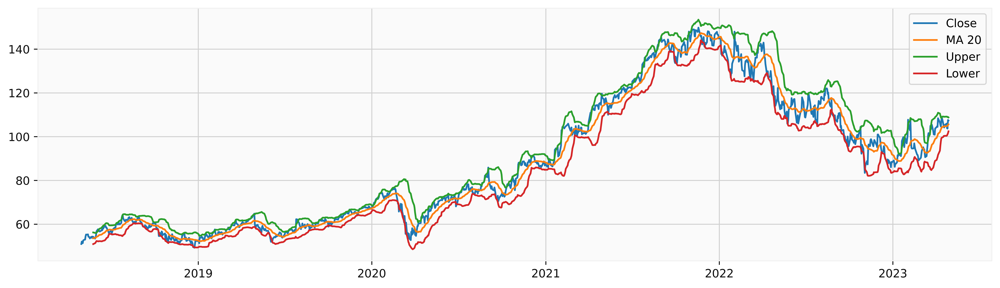

In [ ]:
plt.figure(figsize=(15,4), dpi=1000)
plt.plot(dfc['Close'], label='Close')
plt.plot(dfc['MA for 20 days'], label='MA 20')
plt.plot(dfc['Upper'], label='Upper')
plt.plot(dfc['Lower'], label='Lower')
plt.legend()
plt.show()

### Chỉ số sức mạnh tương đối (RSI)

In [ ]:
delta = df['Adj Close'].diff(1) # Tính toán sự chênh lệch giữa giá trị đóng cửa của mỗi ngày với ngày trước đó
delta.dropna(inplace=True) # Sẽ xóa giá trị NaN trực tiếp trong 'delta' thay vì trả về 1 bản sao

positive = delta.copy() # Sao chép giá trị của delta
negative = delta.copy()

positive[positive < 0] = 0 # Loại bỏ các giá trị âm
negative[negative > 0] = 0 # Loại bỏ các giá trị dương

days = 14 # Chọn khung thời gian
average_gain = positive.rolling(window=days).mean() # Chuyển đổi sang đường trung bình động
average_loss = abs(negative.rolling(window=days).mean()) # Chuyển đổi sang đường trung bình động, chuyển nó thành giá trị dương để xét sự khác biệt tuyệt đối

# Công thức RSI
relative_strength = average_gain / average_loss
RSI = 100.0 - (100.0 / (1.0 + relative_strength))

combined = pd.DataFrame()
combined['Adj Close'] = df['Adj Close']
combined['RSI'] = RSI

# Vẽ biểu đổ
plt.figure(figsize=(20,10), dpi=1000)
ax1 = plt.subplot(211)
ax1.plot(combined.index, combined['Adj Close'])
ax1.set_title("Giá đóng đã điều chỉnh", color='black')

# Đặt thuộc tính cho biểu đồ
ax1.grid(True, color='lightgray') # Thêm các đường kẻ
ax1.set_axisbelow(True) # Cho các đường kẻ nằm dưới đường vẽ
ax1.set_facecolor("white") # Xét màu nền cho ảnh của ô ax1
ax1.figure.set_facecolor('white') # Xét màu nền cho ảnh
# Xét màu cho các chỉ số ở cạnh của ô ax1
ax1.tick_params(axis='x', colors='black') 
ax1.tick_params(axis='y', colors='black')

# Xét màu cho các cạnh của ô ax1
ax1.spines['bottom'].set_color('black')
ax1.spines['top'].set_color('black')
ax1.spines['left'].set_color('black')
ax1.spines['right'].set_color('black')

ax2 = plt.subplot(212, sharex=ax1) # Chia sẻ thuộc tính của cột x ở ax1 cho ax2
ax2.plot(combined.index, combined['RSI'])
# Vẽ các đường kẻ cho các giá trị đặc biệt
ax2.axhline(0, linestyle='--', alpha=0.5, color='#ff0000')
ax2.axhline(10, linestyle='--', alpha=0.5, color='#ffaa00')
ax2.axhline(20, linestyle='--', alpha=0.5, color='#00ff00')
ax2.axhline(30, linestyle='--', alpha=0.5, color='#cccccc')
ax2.axhline(70, linestyle='--', alpha=0.5, color='#cccccc')
ax2.axhline(80, linestyle='--', alpha=0.5, color='#00ff00')
ax2.axhline(90, linestyle='--', alpha=0.5, color='#ffaa00')
ax2.axhline(100, linestyle='--', alpha=0.5, color='#ff0000')

ax2.set_title("giá trị RSI", color='black')
ax2.grid(False)
ax2.set_axisbelow(True)
ax2.set_facecolor("white")
# Xét màu cho các chỉ số ở cạnh của ô ax2
ax2.tick_params(axis='x', colors='black')
ax2.tick_params(axis='y', colors='black')

# Xét màu cho các cạnh của ô ax2
ax2.spines['bottom'].set_color('black')
ax2.spines['top'].set_color('black')
ax2.spines['left'].set_color('black')
ax2.spines['right'].set_color('black')

plt.show()

# So Sánh Với Một Số Cổ Phiếu Khác

In [ ]:
# Tạo danh sách các mã công ty và khoảng thời gian bắt đầu và kết thúc
tech_list = ['GOOGL', 'AAPL', 'MSFT', 'AMZN']
start = dt.datetime(2018, 4, 30)
end = dt.datetime(2023, 4, 28)

# Tải dữ liệu cho các công ty trong danh sách tech_list từ Yahoo Finance
for stock in tech_list:
    globals()[stock] = yf.download(stock, start, end)
    
# Tạo danh sách các công ty từ dữ liệu đã tải về
company_list = [GOOGL, AAPL, MSFT, AMZN]
company_name = ["GOOGLE", "APPLE", "MICROSOFT", "AMAZON"]

# Gán tên công ty cho mỗi DataFrame của công ty tương ứng
for company, com_name in zip(company_list, company_name):
    company["company_name"] = com_name
    
# Kết hợp tất cả các DataFrame của công ty thành một DataFrame lớn
df_company = pd.concat(company_list, axis=0)
df_company

[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


,Open,High,Low,Close,Adj Close,Volume,company_name
Date,,,,,,,
2018-04-30,51.721001,51.918499,50.915001,50.929001,50.929001,34492000,GOOGLE
2018-05-01,50.814999,52.086498,50.530499,52.037498,52.037498,35326000,GOOGLE
2018-05-02,51.700001,52.199001,51.158001,51.302502,51.302502,34698000,GOOGLE
2018-05-03,51.268501,51.534500,50.394501,51.314999,51.314999,39282000,GOOGLE
2018-05-04,50.980499,52.594002,50.902500,52.549999,52.549999,36892000,GOOGLE
...,...,...,...,...,...,...,...
2023-04-21,106.099998,108.150002,105.080002,106.959999,106.959999,86774200,AMAZON
2023-04-24,107.660004,109.230003,105.070000,106.209999,106.209999,69575600,AMAZON
2023-04-25,104.910004,105.449997,102.449997,102.570000,102.570000,65026800,AMAZON


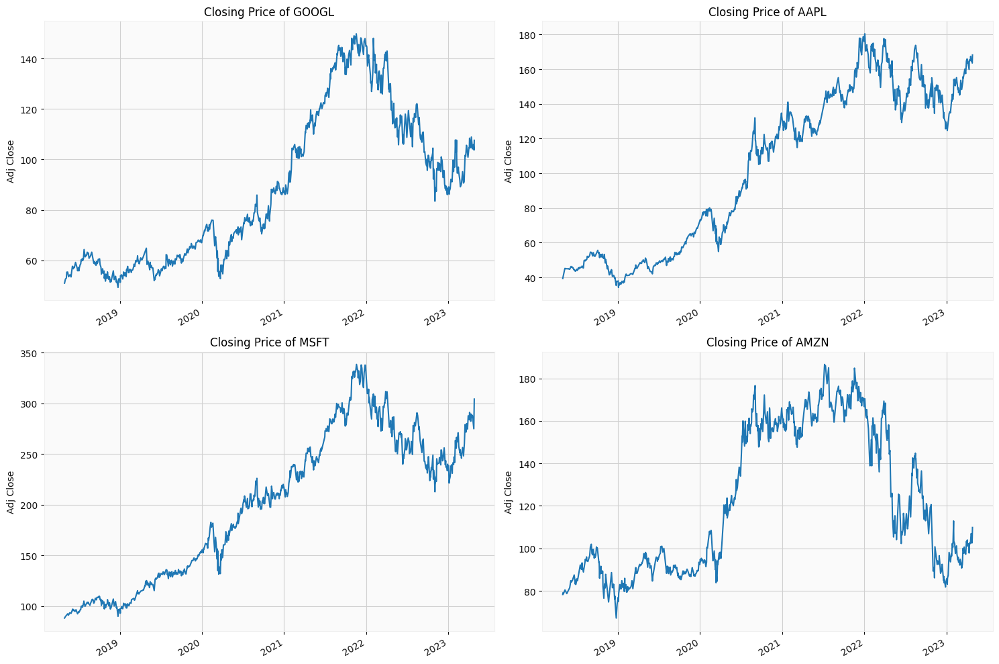

In [ ]:
# Vẽ biểu đồ so sánh giá đóng cửa cho các công ty trong danh sách company_list
plt.figure(figsize=(15, 10))
plt.subplots_adjust(top=1.25, bottom=1.2)

for i, company in enumerate(company_list, 1):
    plt.subplot(2, 2, i)
    company['Adj Close'].plot()
    plt.ylabel('Adj Close')
    plt.xlabel(None)
    plt.title(f"Closing Price of {tech_list[i - 1]}")
    
plt.tight_layout()

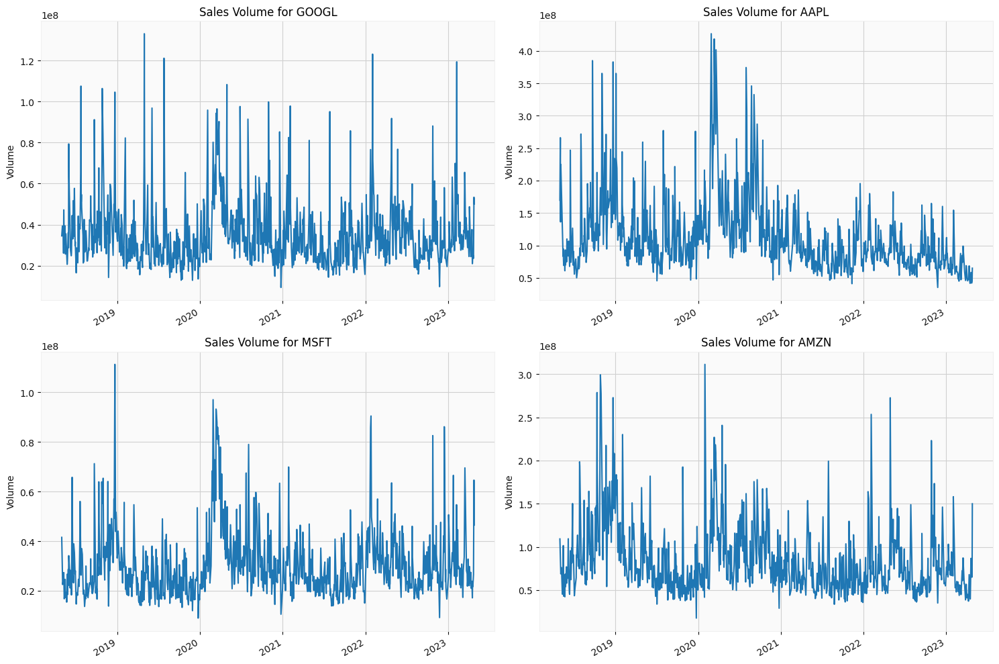

In [ ]:
# Vẽ biểu đồ so sánh khối lượng giao dịch cho các công ty trong danh sách company_list
plt.figure(figsize=(15, 10))
plt.subplots_adjust(top=1.25, bottom=1.2)

for i, company in enumerate(company_list, 1):
    plt.subplot(2, 2, i)
    company['Volume'].plot()
    plt.ylabel('Volume')
    plt.xlabel(None)
    plt.title(f"Sales Volume for {tech_list[i - 1]}")
    
plt.tight_layout()

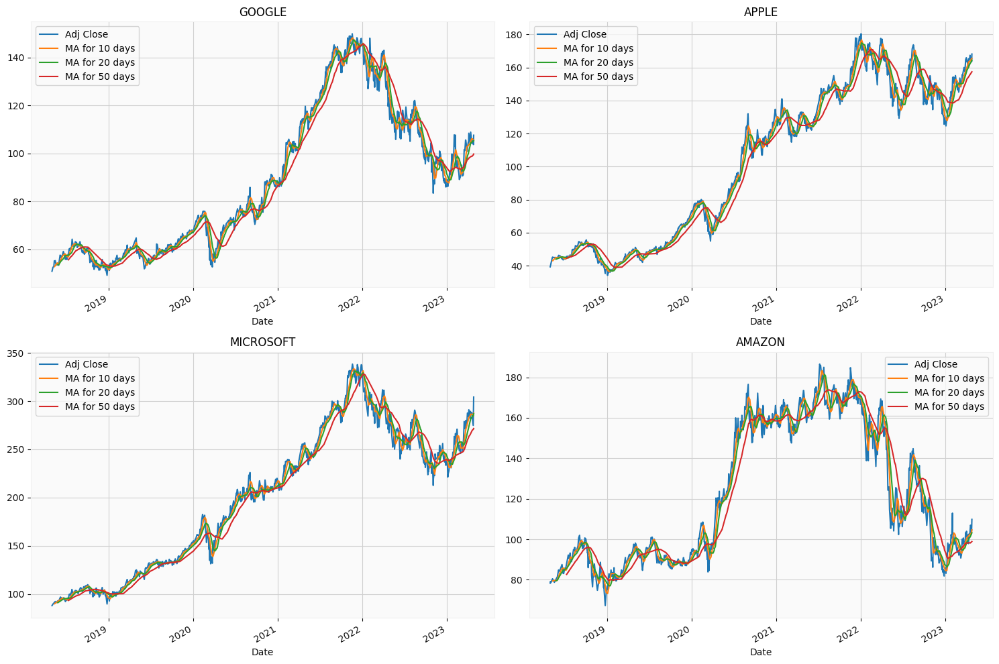

In [ ]:
# Tính toán đường trung bình động cho các mã cổ phiếu trong danh sách company_list và các ngày trong ma_day
ma_day = [10, 20, 50]

for ma in ma_day:
    for company in company_list:
        column_name = f"MA for {ma} days"
        company[column_name] = company['Adj Close'].rolling(ma).mean()

# Vẽ biểu đồ giá đóng cửa và đường trung bình động cho từng công ty trong danh sách company_list
fig, axes = plt.subplots(nrows=2, ncols=2)
fig.set_figheight(10)
fig.set_figwidth(15)

# Biểu đồ cho công ty GOOGL
GOOGL[['Adj Close', 'MA for 10 days', 'MA for 20 days', 'MA for 50 days']].plot(ax=axes[0,0])
axes[0,0].set_title('GOOGLE')

# Biểu đồ cho công ty AAPL
AAPL[['Adj Close', 'MA for 10 days', 'MA for 20 days', 'MA for 50 days']].plot(ax=axes[0,1])
axes[0,1].set_title('APPLE')

# Biểu đồ cho công ty MSFT
MSFT[['Adj Close', 'MA for 10 days', 'MA for 20 days', 'MA for 50 days']].plot(ax=axes[1,0])
axes[1,0].set_title('MICROSOFT')

# Biểu đồ cho công ty AMZN
AMZN[['Adj Close', 'MA for 10 days', 'MA for 20 days', 'MA for 50 days']].plot(ax=axes[1,1])
axes[1,1].set_title('AMAZON')

fig.tight_layout()

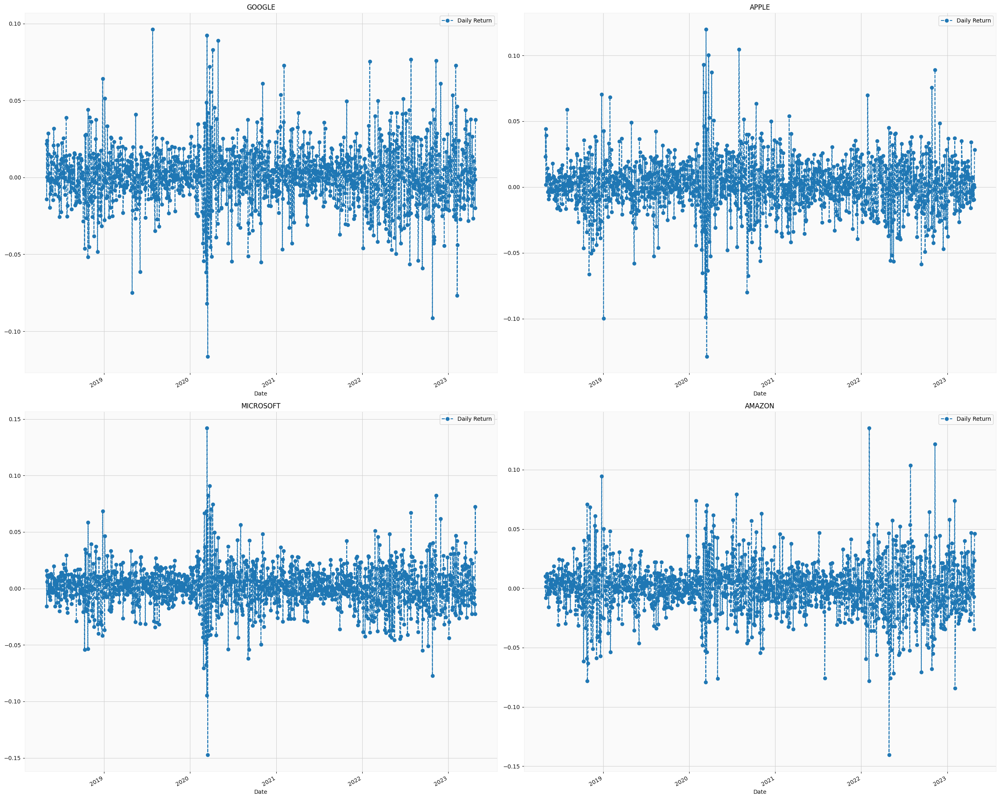

In [ ]:
# Sử dụng pct_change để tính toán tỷ lệ thay đổi hàng ngày cho mỗi công ty trong danh sách company_list
for company in company_list:
    company['Daily Return'] = company['Adj Close'].pct_change()

# Vẽ biểu đồ tỷ lệ hoàn vốn hàng ngày cho các công ty trong danh sách company_list
fig, axes = plt.subplots(nrows=2, ncols=2)
fig.set_figheight(20)
fig.set_figwidth(25)

# Biểu đồ cho công ty GOOGL
GOOGL['Daily Return'].plot(ax=axes[0,0], legend=True, linestyle='--', marker='o')
axes[0,0].set_title('GOOGLE')

# Biểu đồ cho công ty AAPL
AAPL['Daily Return'].plot(ax=axes[0,1], legend=True, linestyle='--', marker='o')
axes[0,1].set_title('APPLE')

# Biểu đồ cho công ty MSFT
MSFT['Daily Return'].plot(ax=axes[1,0], legend=True, linestyle='--', marker='o')
axes[1,0].set_title('MICROSOFT')

# Biểu đồ cho công ty AMZN
AMZN['Daily Return'].plot(ax=axes[1,1], legend=True, linestyle='--', marker='o')
axes[1,1].set_title('AMAZON')

fig.tight_layout()

# Xây Dựng Mô Hình

## ARIMA

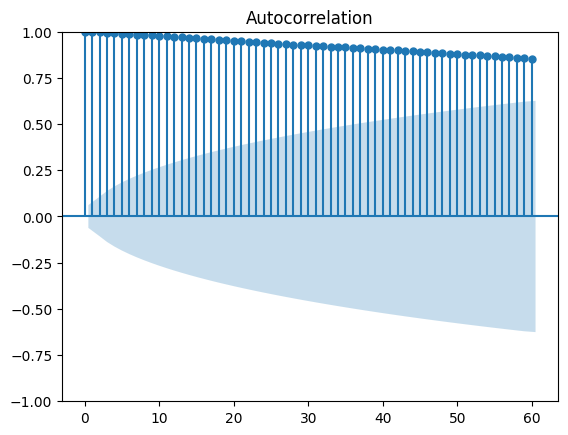

In [67]:
acf_plot = plot_acf(df['Close'][:int(len(df)*0.8)], lags=60)

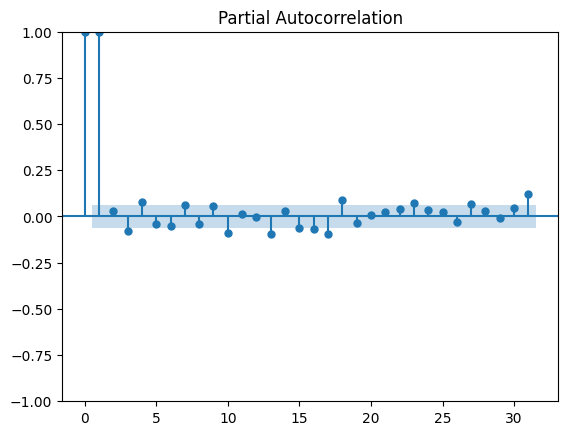

In [68]:
pacf_plot = plot_pacf(df['Close'][:int(len(df)*0.8)])

In [51]:
# # Tách dữ liệu
train_size = int(len(df) * 0.8)
train_data, test_data = df['Close'][:train_size], df['Close'][train_size:]

In [62]:
# Huấn luyện mô hình ARIMA
model = ARIMA(train_data, order=(3, 1, 0))
model_fit = model.fit()

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


In [63]:
predictions = model_fit.predict(start=len(train_data), end=len(train_data) + len(test_data) - 1, typ='levels')

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(


In [69]:
MSE = mean_squared_error(test_data, predictions)
MAPE = mean_absolute_percentage_error(test_data, predictions)
R2 = r2_score(test_data, predictions)
print(f"MSE: {MSE}\nMAPE: {MAPE}\nR2: {R2}")

MSE: 222.0149843595889
MAPE: 0.1278890587486338
R2: -1.4558381708652925


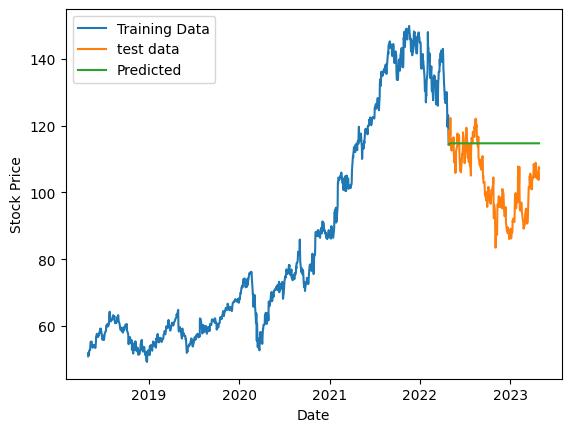

In [65]:
plt.plot(train_data.index, train_data, label='Training Data')
plt.plot(test_data.index, test_data, label='test data')
plt.plot(test_data.index, predictions, label='Predicted')
plt.xlabel('Date')
plt.ylabel('Stock Price')
plt.legend()
plt.show()

## LinearRegression, pipeline, gridSearchCV
(Hồi quy Tuyến Tính)

In [9]:
from sklearn.preprocessing import scale  # Chuẩn hóa dữ liệu.
from sklearn.preprocessing import StandardScaler  # Chuẩn hóa dữ liệu.
from sklearn.pipeline import Pipeline  # Xây dựng pipeline xử lý dữ liệu.
from sklearn.model_selection import GridSearchCV  # Tìm kiếm siêu tham số tốt nhất.
from sklearn.linear_model import LinearRegression  # Sử dụng mô hình hồi quy tuyến tính.
from sklearn.model_selection import train_test_split  # Chia dữ liệu thành tập huấn luyện và tập kiểm tra.

In [7]:
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):
    n_vars = 1 if type(data) is list else data.shape[1] # Xác định số lượng biến n_vars trong dữ liệu đầu vào.
    df = pd.DataFrame(data) # Tạo DataFrame df từ dữ liệu đầu vào.
    cols, names = list(), list()
	  # Tạo các cột đầu vào (input sequence) với độ trễ từ t-n đến t-1
    for i in range(n_in, 0, -1):
        cols.append(df.shift(i))
        names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
	  # Tạo các cột đầu ra (forecast sequence) từ tới t+n
    for i in range(0, n_out):
        cols.append(df.shift(-i))
        if i == 0:
            names += [('var%d(t)' % (j+1)) for j in range(n_vars)]
        else:
            names += [('var%d(t+%d)' % (j+1, i)) for j in range(n_vars)]
	  # Kết hợp các cột lại thành một DataFrame mới
    agg = pd.concat(cols, axis=1)
    agg.columns = names
	  # Loại bỏ các dòng có giá trị NaN (nếu dropnan=True)
    if dropnan:
        agg.dropna(inplace=True)
    return agg

In [18]:
def draw_true_predict(y_true, y_pred):
    size = len(y_true)
    plt.figure(figsize=(15,4))
    plt.plot(list(range(size)), y_true, label='Thực', color='blue')
    plt.plot(list(range(size)), y_pred, label='Dự đoán', color='red')
    plt.legend(loc='best')
    plt.title('Giá trị thực so với dự đoán')
    plt.show()

In [17]:
def calculate_metrics(Y_test, pred):
    MSE = mean_squared_error(Y_test, pred)
    MAPE = mean_absolute_percentage_error(Y_test, pred)
    R2 = r2_score(Y_test, pred)
    print(f"MSE: {MSE}\nMAPE: {MAPE}\nR2: {R2}")

In [ ]:
dataset = pd.DataFrame(df['Close'])  # Tạo DataFrame dataset từ cột 'Close' của DataFrame df.

data = series_to_supervised(dataset, n_in=4, n_out=1)  # Chuyển đổi dataset thành dữ liệu chuỗi thời gian với độ trễ 4 và dự báo 1.
X, Y = data[['var1(t-4)', 'var1(t-3)', 'var1(t-2)', 'var1(t-1)']], data['var1(t)']  # Tách dữ liệu đầu vào X và đầu ra Y từ data.

x = scale(X)  # Chuẩn hóa dữ liệu đầu vào X
y = scale(Y)  # Chuẩn hóa dữ liệu đầu ra Y

X_train, X_test, Y_train, Y_test = train_test_split(x, y, test_size=0.2, shuffle=False, random_state=1)  # Chia dữ liệu thành tập huấn luyện và tập kiểm tra.

pipeline = Pipeline([
    ('scaler', StandardScaler()),
    ('reg', LinearRegression())
])  # Xây dựng pipeline với bước đầu tiên là chuẩn hóa dữ liệu bằng StandardScaler và bước thứ hai là sử dụng mô hình hồi quy tuyến tính.

param_grid = {
    'reg__fit_intercept': [True, False],
    'reg__positive': [True, False]
}  # Thiết lập siêu tham số để tìm kiếm siêu tham số tốt nhất cho mô hình.

grid = GridSearchCV(pipeline, param_grid=param_grid, cv=5)  # Tạo đối tượng GridSearchCV để tìm kiếm siêu tham số tốt nhất.
grid.fit(X_train, Y_train)  # Huấn luyện mô hình trên tập huấn luyện.
print(grid.best_params_)  # In ra siêu tham số tốt nhất được tìm kiếm bởi GridSearchCV.
pred = grid.predict(X_test)  # Dự đoán đầu ra trên tập kiểm tra.

{'reg__fit_intercept': True, 'reg__positive': True}


MSE: 0.007264161713060419
MAPE: 0.4225990354120385
R2: 0.9284600181471007


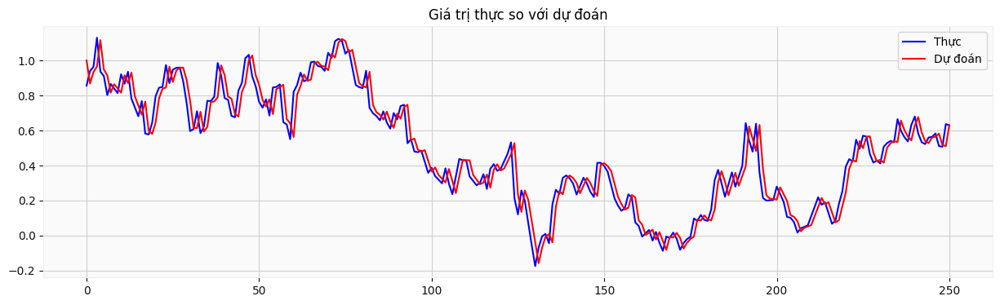

In [ ]:
calculate_metrics(Y_test, pred)
draw_true_predict(Y_test, pred)

## LSTM

In [ ]:
# Chuẩn bị dữ liệu
df1 = pd.DataFrame(df['Close']) # Tạo DataFrame mới từ cột 'Close' của DataFrame df.
data = df1.values # Chuyển đổi DataFrame thành mảng NumPy.
training_data_len = math.ceil(len(data) * .8) # Độ dài của dữ liệu huấn luyện, là phần tròn lên 80% số mẫu.
train_data = data[:training_data_len]
test_data = data[training_data_len:]

In [ ]:
# Chuẩn hóa dữ liệu
sc = MinMaxScaler(feature_range=(0, 1)) # Tạo một đối tượng MinMaxScaler với phạm vi giữa 0 và 1.
sc_train = sc.fit_transform(data) # Áp dụng MinMaxScaler lên dữ liệu (data) và trả về dữ liệu đã được chuẩn hóa.

In [ ]:
# Chia thành tập huấn luyện
x_train, y_train = [], []
for i in range(60, len(train_data)):
    # Tạo dữ liệu đầu vào x_train bằng cách lấy 60 mẫu liên tiếp từ sc_train
    x_train.append(sc_train[i-60:i, 0])
    # Tạo dữ liệu đầu ra y_train bằng cách lấy mẫu tiếp theo sau 60 mẫu đầu vào từ sc_train
    y_train.append(sc_train[i, 0])

In [ ]:
# Xếp dữ liệu thành mảng
x_train, y_train = np.array(x_train), np.array(y_train)

# Xếp lại dữ liệu thành mảng có chiều thích hợp
x_train = np.reshape(x_train, (x_train.shape[0], x_train.shape[1], 1))
y_train = np.reshape(y_train, (y_train.shape[0], 1))

In [ ]:
model = Sequential()   # Khởi tạo một mô hình tuần tự (Sequential).
model.add(LSTM(256, return_sequences=True, input_shape=(x_train.shape[1], 1)))  # Thêm một lớp LSTM với 256 đơn vị, trả về chuỗi kết quả, và input shape phù hợp với kích thước của x_train.
model.add(Dropout(0.2)) # Thêm một lớp Dropout với tỷ lệ loại bỏ 0.2 để tránh overfitting.
model.add(LSTM(128, return_sequences=True)) # Thêm một lớp LSTM với 128 đơn vị, trả về chuỗi kết quả.
model.add(Dropout(0.2)) # Thêm một lớp Dropout với tỷ lệ loại bỏ 0.2.
model.add(LSTM(64)) # Thêm một lớp LSTM với 64 đơn vị.
model.add(Dropout(0.2)) # Thêm một lớp Dropout với tỷ lệ loại bỏ 0.2.
model.add(Dense(1)) # Thêm một lớp Dense với 1 đơn vị đầu ra.
model.compile(loss='mean_absolute_error', optimizer='adam') # Biên dịch mô hình với hàm sai số là 'mean_absolute_error' và bộ tối ưu hóa là 'adam'.

In [ ]:
def train_model(x_train, y_train, model, n=1):
  save_model = "save_model.hdf5"  # Tên file để lưu mô hình có hiệu suất tốt nhất.
  best_model = ModelCheckpoint(save_model, monitor='loss', verbose=2, save_best_only=True, mode='auto') # Lưu mô hình có hiệu suất tốt nhất dựa trên giá trị sai số thấp nhất.
  for i in range(n):
    print('\nRound ', i+1)  # In ra thông báo vòng lặp huấn luyện hiện tại.
    model.fit(x_train, y_train, batch_size=30, epochs=60, callbacks=[best_model]) # Huấn luyện mô hình với các tham số batch_size và epochs đã cho, sử dụng callback để lưu mô hình có hiệu suất tốt nhất.
    model = load_model('save_model.hdf5') # Tải mô hình có hiệu suất tốt nhất đã được lưu trữ.
  return model  # Trả về mô hình đã được huấn luyện

In [ ]:
final_model = train_model(x_train, y_train, model, 2)


Round  1
Epoch 1/60
32/32 [==============================] - ETA: 0s - loss: 0.0994
Epoch 1: loss improved from inf to 0.09938, saving model to save_model.hdf5
32/32 [==============================] - 12s 16ms/step - loss: 0.0994
Epoch 2/60
28/32 [=========================>....] - ETA: 0s - loss: 0.0427
Epoch 2: loss improved from 0.09938 to 0.04362, saving model to save_model.hdf5
32/32 [==============================] - 0s 11ms/step - loss: 0.0436
Epoch 3/60
28/32 [=========================>....] - ETA: 0s - loss: 0.0449
Epoch 3: loss did not improve from 0.04362
32/32 [==============================] - 0s 10ms/step - loss: 0.0449
Epoch 4/60
28/32 [=========================>....] - ETA: 0s - loss: 0.0423
Epoch 4: loss improved from 0.04362 to 0.04131, saving model to save_model.hdf5
32/32 [==============================] - 0s 12ms/step - loss: 0.0413
Epoch 5/60
29/32 [==========================>...] - ETA: 0s - loss: 0.0380
Epoch 5: loss improved from 0.04131 to 0.03886, saving mode

In [ ]:
# Chia tập kiểm tra
test = df1[len(train_data)-60:].values
test = test.reshape(-1,1)  # Thay đổi hình dạng của dữ liệu kiểm tra thành (số lượng mẫu, 1) để phù hợp với đầu vào mô hình.
sc_test = sc.transform(test) # Áp dụng MinMaxScaler lên dữ liệu kiểm tra để chuẩn hóa.

In [ ]:
x_test = []
for i in range(60, test.shape[0]):
    x_test.append(sc_test[i-60:i, 0]) # Tạo dữ liệu đầu vào x_test cho dự đoán bằng cách lấy 60 mẫu liên tiếp từ sc_test.
x_test = np.array(x_test) # Chuyển đổi x_test thành mảng NumPy.
x_test = np.reshape(x_test, (x_test.shape[0], x_test.shape[1], 1))  # Xếp lại x_test thành mảng có chiều thích hợp.


y_test = data[training_data_len:]  # Lấy dữ liệu đầu ra thực tế (y_test) từ data bắt đầu từ training_data_len đến cuối.
y_test_pred = final_model.predict(x_test) # Dự đoán đầu ra y_test_pred bằng cách sử dụng mô hình final_model trên dữ liệu đầu vào x_test.
y_test_pred = sc.inverse_transform(y_test_pred) # Đảo ngược chuẩn hóa dữ liệu dự đoán y_test_pred bằng cách áp dụng phép nghịch đảo của MinMaxScaler (sc).

8/8 [==============================] - 1s 7ms/step


<ipython-input-17-eb38e8b7ea0b>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_data1['Pred'] = y_test_pred


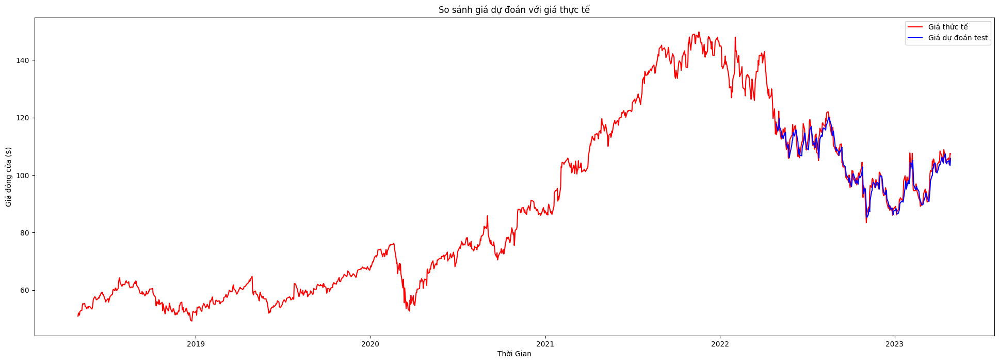

In [ ]:
test_data1 = df1[training_data_len:]

plt.figure(figsize=(24, 8))
plt.plot(df1, label='Giá thức tế', color='red')
test_data1['Pred'] = y_test_pred
plt.plot(test_data1['Pred'], label="Giá dự đoán test", color='blue')
plt.title("So sánh giá dự đoán với giá thực tế")
plt.xlabel("Thời Gian")
plt.ylabel("Giá đóng cửa ($)")
plt.legend()
plt.show()

In [ ]:
print("R2: ", r2_score(y_test, y_test_pred))
print("MAE: ", mean_absolute_error(y_test, y_test_pred))
print("MSE: ", mean_squared_error(y_test, y_test_pred))
print("MAPE: ", mean_absolute_percentage_error(y_test, y_test_pred))

R2:  0.9200993891882179
MAE:  2.10190159066274
MSE:  7.177187376937712
MAPE:  0.020298550538550123
